In [10]:
import geopandas as gpd
import ee

In [11]:
#ee.Authenticate()

Enter verification code:  4/1AZEOvhWqIWQbqWpRfi7aih4F9OQ8JMji8m9uApiOjf5-xqsZ0wmyF9uxgwk



Successfully saved authorization token.


In [12]:
ee.Initialize()

In [7]:
labels = gpd.read_file("gs://esg-satelite-data-warehouse/mars/mars_labels/Orlov_TempeTerra_fault_catalogue.shp")

In [9]:
labels.head(3)

,FaultSet,Age,Strike,Length_km,Dip_Dir,Start_X,Start_Y,End_X,End_Y,geometry
0,Set H5,EH,36.316102,39.53500,126.316102,-169302.910789,1.148928e+06,-154894.222968,1.168429e+06,"LINESTRING (-4784208.136 2297855.975, -4780239..."
1,Set H6,EH,28.711558,11.47720,118.711558,-148876.720567,1.163294e+06,-145456.456156,1.169530e+06,"LINESTRING (-4743355.755 2326588.569, -4742086..."
2,Set H5,EH,47.031921,6.53008,137.031921,-168363.775966,1.136511e+06,-165506.270251,1.139170e+06,"LINESTRING (-4782329.866 2273022.518, -4780821..."


<Axes: >

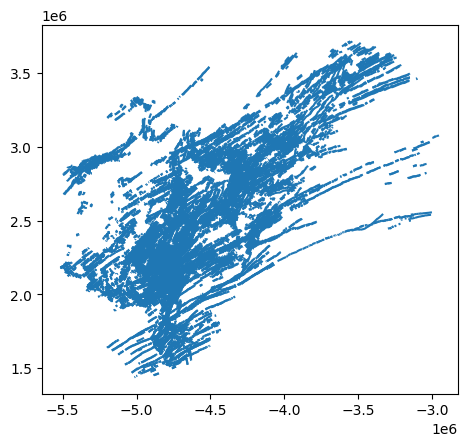

In [28]:
labels.plot()

In [13]:
import folium

In [29]:
#folium.Map()

In [26]:
""" 
I was trying to follow this tutorial to do some plots with geopandas:
https://geopandas.org/en/stable/gallery/plotting_with_geoplot.html
but after installing geoplot, I'm just getting error after error.

At first it was to do with the cartopy package (I think) which you install with
"conda install -c conda-forge cartopy", but then I kept getting an error
"ImportError: cannot import name 'suppress_warnings' from 'numpy.testing'"
which looks like it comes from a line of code from scipy but scipy works with my version of
numpy so god knows what's happening
"""
#import geoplot # note for install geoplot I had to do: conda install -c conda-forge cartopy

In [27]:
#geoplot.polyplot(labels, figsize=(8, 4))

In [ ]:
# https://www.openplanetary.org/opm/basemaps basemap 

In [60]:
folium.Map(#location=[0, 30],
           #zoom_start=4, min_zoom=4, max_zoom=10,
           #max_bounds=True,
           #min_lon=0, max_lon=70, min_lat=-40, max_lat=40,
           tiles='https://cartocdn-gusc.global.ssl.fastly.net//ramirocartodb/api/v1/map/named/tpl_756aec63_3adb_48b6_9d14_331c6cbc47cf/all/{z}/{x}/{y}.png',
           attr='Textures and Icons from https://www.textures.com/ & https://thenounproject.com/')

In [62]:
folium.Map(#location=[0, 30],
             #zoom_start=0, min_zoom=0, max_zoom=10,
           #max_bounds=True,
           #min_lon=0, max_lon=70, 
            #min_lat=0, max_lat=10,
           tiles='http://s3-eu-west-1.amazonaws.com/whereonmars.cartodb.net/mola-gray/{z}/{x}/{y}.png',
           attr='Texture from https://www.openplanetary.org/opm-basemaps/shaded-grayscale-mola-elevation')

In [50]:
folium.Map(#location=[0, 30],
             #zoom_start=0, min_zoom=0, max_zoom=10,
           #max_bounds=True,
           #min_lon=0, max_lon=70, 
            #min_lat=-40, max_lat=40,
           tiles='http://s3-eu-west-1.amazonaws.com/whereonmars.cartodb.net/celestia_mars-shaded-16k_global/{z}/{x}/{y}.png',
           attr='Texture from https://www.openplanetary.org/opm-basemaps/shaded-grayscale-mola-elevation')

In [101]:
import shapely

In [104]:
labels_transformed = labels
labels_transformed["geometry"] = labels_transformed.geometry.map(lambda polygon: shapely.ops.transform(lambda x, y: (y, x), polygon))

In [88]:
import os

In [89]:
os.environ["PROJ_IGNORE_CELESTIAL_BODY"] = "YES"

In [68]:
mars_elev_basemap = 'http://s3-eu-west-1.amazonaws.com/whereonmars.cartodb.net/mola-gray/{z}/{x}/{y}.png'

In [90]:
m = folium.Map(location=[-169302, 1148928], zoom_start=4, tiles=mars_elev_basemap, attr = "attribution here")


In [91]:
_ = folium.GeoJson(labels).add_to(m)

In [83]:
#for x in range(len(labels)):
    #_ = folium.GeoJson(labels.iloc[x]["geometry"]).add_to(m)

In [92]:
m

In [112]:
x1,y1,x2,y2 = labels_transformed['geometry'].total_bounds

In [113]:
x1

1438998.8295698091

In [118]:
m = folium.Map(tiles=mars_elev_basemap, attr = "attribution here")

In [122]:
[y1, x1], [y2, x2]

([-5513754.626895812, 1438998.8295698091],
 [-2953891.390898697, 3712431.3929004148])

In [119]:
#m.fit_bounds([[y1, x1], [y2, x2]])

In [123]:
m.fit_bounds([[0,30], [40,40]])

In [124]:
m

In [116]:
folium.GeoJson(labels_transformed["geometry"]).add_to(m)

In [125]:
labels

,FaultSet,Age,Strike,Length_km,Dip_Dir,Start_X,Start_Y,End_X,End_Y,geometry
0,Set H5,EH,36.316102,39.53500,126.316102,-169302.910789,1.148928e+06,-154894.222968,1.168429e+06,"LINESTRING (2297855.975 -4784208.136, 2302353...."
1,Set H6,EH,28.711558,11.47720,118.711558,-148876.720567,1.163294e+06,-145456.456156,1.169530e+06,"LINESTRING (2326588.569 -4743355.755, 2328957...."
2,Set H5,EH,47.031921,6.53008,137.031921,-168363.775966,1.136511e+06,-165506.270251,1.139170e+06,"LINESTRING (2273022.518 -4782329.866, 2274371...."
3,Set H5,EH,220.356881,4.21134,310.356881,-166083.823997,1.154325e+06,-167760.936201,1.152350e+06,"LINESTRING (2308650.396 -4777769.962, 2307863...."
4,Set H6,EH,32.849520,14.73630,122.849520,-161852.569055,1.130185e+06,-157021.886330,1.137653e+06,"LINESTRING (2260369.557 -4769307.452, 2262017...."
...,...,...,...,...,...,...,...,...,...,...
23733,Set H6,EH,207.683512,11.81470,297.683512,-149219.419189,1.571104e+06,-153188.177127,1.563524e+06,"LINESTRING (3142208.893 -4744041.153, 3139033...."
23734,Set H6,EH,18.965801,13.92070,108.965801,339072.124456,1.561163e+06,342352.964351,1.570688e+06,"LINESTRING (3122325.423 -3767458.065, 3128887...."
23735,Set H6,EH,197.184902,12.45840,287.184902,342776.298531,1.569841e+06,340130.459906,1.561269e+06,"LINESTRING (3139682.124 -3760049.717, 3131850...."
23736,Set H6,EH,31.549050,6.89635,121.549050,-238790.287084,1.276311e+06,-236448.719901,1.280121e+06,"LINESTRING (2552622.156 -4923182.888, 2556273...."


In [152]:
mars_elev_basemap2 = "http://s3-eu-west-1.amazonaws.com/whereonmars.cartodb.net/celestia_mars-shaded-16k_global/{z}/{x}/{y}.png"

In [153]:
labels_transformed = labels
labels_transformed["geometry"] = labels_transformed.geometry.map(lambda polygon: shapely.ops.transform(lambda x, y: (y, x), polygon))

In [154]:
labels_epsg = labels_transformed.to_crs('epsg:4326')

In [155]:
x1,y1,x2,y2 = labels_epsg['geometry'].total_bounds

In [156]:
m = folium.Map(tiles=mars_elev_basemap2, attr = "attribution here")

In [157]:
m.fit_bounds([[y1, x1], [y2, x2]])

In [158]:
folium.GeoJson(labels_epsg["geometry"]).add_to(m)

In [159]:
m